# Running the ABM for DPD (Detroit, Michigan)

This notebook provides a simple example of how to run the ABM for the case study of DPD (Detroit, Michigan). The ABM simulates the spatial movements of police patrols as they respond to the incoming incidents that occured on the chosen shift (time period).

We will run the example for a low-demand scenario (scenario1), i.e. using historical data from weekdays day shifts.

In [1]:
import os
print(os.getcwd())

import osmnx as ox
import pandas as pd

import datetime as dt
import numpy as np
import scipy as sp

import sys
sys.path.append('../../src/ABM/')

import ModelFramework
import importlib

import AgentFramework
import BeatFramework
import GraphFramework
import IncidentFramework
import importlib
importlib.reload(IncidentFramework)

import Env
importlib.reload(Env)


import geopandas as gpd
import random

import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import seaborn as sns
import matplotlib as mpl
import pickle
import datetime

import io
from contextlib import redirect_stdout

import warnings

import SchedulerFramework

/Users/natachachenevoy/Documents/GitHub/police-deployment-optimisation/dpd_case_study/ABM_running_example


### Select a the scenario (1: low-demand, 2: high-demand)
Here we pick a low-demand scneario.

In [2]:
# Low-demand scenario
scenario = 1 # <- CHANGE HERE

### Select a shift (time period) to run the simulation
Here we pick the first shift in test set.

In [26]:
with open('../ABM_experiments/testing_set_scenario{}.pkl'.format(scenario), 'rb') as f:
    list_shifts = pickle.load(f)
    

shift = list_shifts[0]
ABM_START_DATETIME = shift[0]
ABM_END_DATETIME = shift[1]

print('Chosen shift: {}-{}'.format(ABM_START_DATETIME, ABM_END_DATETIME))

Chosen shift: 2019-03-19 08:00:00-2019-03-19 16:00:00


### Initialise the model environment

In [4]:
# Get all the incidents for the 100 training_set time periods (2018) 
def getIncidentsForScenario(incidents, scenario_num):
    with open('../ABM_experiments/training_set_scenario{}.pkl'.format(scenario_num), 'rb') as f:
        training_set_scenario = pickle.load(f)

    incidents['Patrol_beat'] = incidents['Patrol_beat'].apply(str)
    #historical_crimes['Precinct'] = historical_crimes['Precinct'].apply(str)
    incidents.Date_Time = pd.to_datetime(incidents.Date_Time)
    # get the incidents that occured in each shift
    historical_incidents_scenario = pd.DataFrame()
    for shift in training_set_scenario:
        historical_incidents_scenario = historical_incidents_scenario.append(incidents[(incidents['Date_Time'] >= shift[0]) & 
                                    (incidents['Date_Time'] < shift[1])])


    return historical_incidents_scenario

In [5]:
def get_ABM_env(ABM_START_DATETIME, ABM_END_DATETIME, scenario) :
    warnings.filterwarnings('ignore')

    # historical_crimes is used in ABM_env to calculate score on patrolling edges
    # historical_cfs not used in ABM_env but we use it to calculate the targeted configuraiton 
    # we select those CFS incidents from training set 2018
    incidents = pd.read_csv("../../data/incidents.csv")
    historical_cfs_scenario = getIncidentsForScenario(incidents, scenario)
    crimes = pd.read_csv("../../data/crimes.csv")
    historical_crimes_scenario = getIncidentsForScenario(crimes, scenario)


    incidents.Date_Time = pd.to_datetime(incidents.Date_Time)
    incidents.Date_Time = incidents.Date_Time.dt.tz_localize(None)
    incidents['Patrol_beat'] = incidents['Patrol_beat'].apply(str)
    incidents['Precinct'] = incidents['Precinct'].apply(str)
    # get all incidents within the time interval of the shift
    cfs_incidents_shift= incidents[(incidents['Date_Time'] >= ABM_START_DATETIME) & 
                                    (incidents['Date_Time'] < ABM_END_DATETIME)]


    ABM_env = Env.Environment('../../', cfs_incidents_shift, ABM_START_DATETIME, ABM_END_DATETIME, historical_cfs_scenario = historical_cfs_scenario, historical_crimes_scenario = historical_crimes_scenario)
    warnings.filterwarnings('default')
    print('... env imported.')
    return ABM_env

In [6]:
# This may take some time...
ABM_env_scenario = get_ABM_env(ABM_START_DATETIME, ABM_END_DATETIME, scenario=scenario)

31 streets with incidents found in beat 415
13 streets with incidents found in beat 411
18 streets with incidents found in beat 412
only found 4 streets with incidents
34 streets with incidents found in beat 408
32 streets with incidents found in beat 407
64 streets with incidents found in beat 409
25 streets with incidents found in beat 414
65 streets with incidents found in beat 410
32 streets with incidents found in beat 404
51 streets with incidents found in beat 405
18 streets with incidents found in beat 406
62 streets with incidents found in beat 612
@@@@@@@ No path was found between nodes [62577537] and target 62577462
Authorizing driving on one way road from agent pos!
73 streets with incidents found in beat 310
26 streets with incidents found in beat 401
26 streets with incidents found in beat 402
10 streets with incidents found in beat 403
134 streets with incidents found in beat 311
42 streets with incidents found in beat 307
71 streets with incidents found in beat 709
154 

### Choose a configuration to run the model on

In [7]:
def getRandomConfig(k, ABM_env) :
   
    # Init the configuration with zero agent in each patrol beat
    list_num_agents_scas = np.zeros((len(ABM_env.patrol_beats),), dtype=int)

    # randomly select k scas within precinct
    #random.seed(222)
    chosen_scas = random.sample(ABM_env.patrol_beats, k)

    for sca in chosen_scas:
        list_index = ABM_env.patrol_beats.index(sca)
        #print("list_index", list_index)
        list_num_agents_scas[list_index] = 1

    # create config dict
    pairs = zip(ABM_env.patrol_beats, list_num_agents_scas)
    # Create a dictionary from zip object
    configuration = dict(pairs)
    return configuration

In [8]:
def getTargettedConfig(k, ABM_env, historical_data_type = 'CFS') :
    # Init the configuration with zero agent in each patrol beat
    list_num_agents_scas = np.zeros((len(ABM_env.patrol_beats),), dtype=int)

    # CHOOSE k HOTTEST SCAS in force
    if historical_data_type == 'CFS' :
        list_num_crimes = [len(sca.historical_cfs) for sca in ABM_env.patrol_beats]
    else :
        # get the list of num of crimes 
        list_num_crimes = [len(sca.historical_crimes) for sca in ABM_env.patrol_beats]
        
        
    # create a dictionnary {beat : num_crimes} combining both lists
    dict_crime_in_beats = dict(zip(ABM_env.patrol_beats, list_num_crimes))
    # get k pairs (beat, num_crimes)
    ordered_list_beats = sorted(dict_crime_in_beats.items(), key=lambda item: item[1], reverse=True)[:k]
    # get only the beat part of that pair
    chosen_scas = [pair[0] for pair in ordered_list_beats]

    for sca in chosen_scas:
        list_index = ABM_env.patrol_beats.index(sca)
        list_num_agents_scas[list_index] = 1

    # create config dict
    pairs = zip(ABM_env.patrol_beats, list_num_agents_scas)
    # Create a dictionary from zip object
    configuration = dict(pairs)
    return configuration

In [9]:
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap



def plotConfig(config, title) :
        
    # convert patrol beat objects to their name
    list_staffed_beats= [k for k,v in config.items() if v == 1]
    list_staffed_beats = [beat.name for beat in list_staffed_beats]

    precincts = gpd.read_file('../../data/precincts/precincts.shp')

    scas = gpd.read_file('../../data/patrol_beats/patrol_beats.shp')

    #scas = scas.join(num_inc_df, on = 'name')
    # create new column with has_patrol (config)
    scas[scas['name'].isin(list_staffed_beats)]

    scas['has_patrol'] = np.where(scas['name'].isin(list_staffed_beats), 1, 0)
    scas.loc[:,['name']] = scas.name.astype('int64')

    #scas['has_patrol'] = ['Staffed' if sca['has_patrol'] else 'Unstaffed' for index, sca in scas.iterrows()]
    scas['has_patrol'] = scas['has_patrol'].astype('str')


   
    # create simple linear colormap that maps grey to blue
    cmap = LinearSegmentedColormap.from_list(
        'mycmap', [(0, 'white'), (1, '#86beda')])


    fig, ax = plt.subplots(1, figsize=(30, 30))
    scas.plot(ax=ax, column='has_patrol', edgecolor= 'black', legend=True, cmap=cmap)
    #scas.apply(lambda x: ax.annotate(s=int(x['name']), xy=x.geometry.centroid.coords[0], ha='center', fontfamily = 'sans-serif', weight='bold', fontsize=18),axis=1);

    for index, sca in scas.iterrows():
        if sca['name'] == 712 :
            ax.annotate(int(sca['name']), # this is the text
                        xy=sca.geometry.centroid.coords[0],
                        weight='bold', 
                        fontsize=18,
                        textcoords="offset points", # how to position the text
                        xytext=(0,-15),
                        ha='center')
        elif sca['name'] == 1105 :
                ax.annotate(int(sca['name']), # this is the text
                            xy=sca.geometry.centroid.coords[0],
                            weight='bold', 
                            fontsize=18,
                            textcoords="offset points", # how to position the text
                            xytext=(0,25),
                            ha='center')
        elif sca['name'] == 702 :
                ax.annotate(int(sca['name']), # this is the text
                            xy=sca.geometry.centroid.coords[0],
                            weight='bold', 
                            fontsize=18,
                            textcoords="offset points", # how to position the text
                            xytext=(0,-10),
                            ha='center')
        elif sca['name'] == 908 :
                ax.annotate(int(sca['name']), # this is the text
                            xy=sca.geometry.centroid.coords[0],
                            weight='bold', 
                            fontsize=18,
                            textcoords="offset points", # how to position the text
                            xytext=(10,0),
                            ha='center')
        else : 
            ax.annotate(int(sca['name']), # this is the text
                            xy=sca.geometry.centroid.coords[0],
                            weight='bold', 
                            fontsize=18,
                            ha='center')



    
    #Precincts
    precincts.boundary.plot(ax=ax, linewidth = 5, color = 'black', zorder = 1)


    leg = ax.get_legend()
    #leg.set_title('Staffed')
    leg.get_texts()[0].set_fontsize('1')
    leg.get_texts()[0].set_text('')

    leg.get_texts()[1].set_fontsize('30')
    leg.get_texts()[1].set_text('Staffed')
    
    # remove frame legend
    leg.get_frame().set_linewidth(0.0)
    
    ## LEGEND COLORBAR
    """sm = plt.cm.ScalarMappable(cmap='OrRd', norm=plt.Normalize(vmin=scas['num_inc_per_day_per_area'].min(), vmax=scas['num_inc_per_day_per_area'].max()))
    cbar = plt.colorbar(sm, fraction=0.025, pad=0.02, orientation= 'horizontal')
    cbar.ax.tick_params(labelsize=25)
    cbar.set_label(label='Average daily number of historical crimes per km2',size=25)
     """


    ax.set_title(title, fontsize = 30, )
    
    ax.axis('off')

    #move legend to an empty space

    #plt.savefig(file_title, bbox_inches = 'tight')

    plt.show()

In [10]:
num_agents = 20 # <- CHANGE HERE

# Get targetted configuration 
targetted_config = getTargettedConfig(num_agents, ABM_env_scenario)

# OR get random configuration
random_config = getRandomConfig(num_agents, ABM_env_scenario)

TARGETED


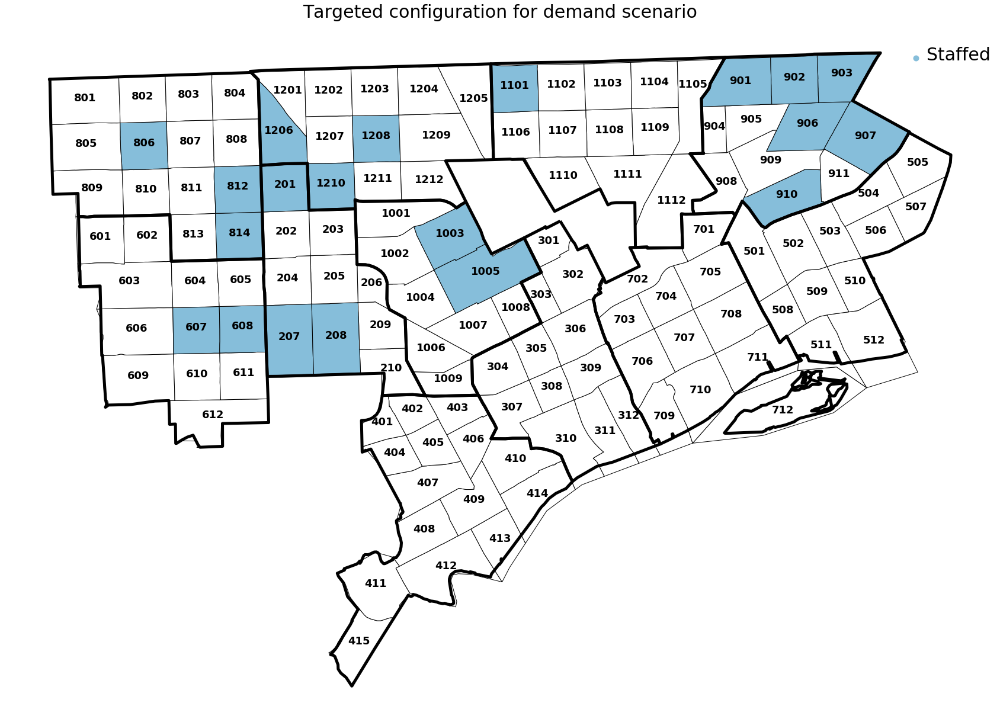

RANDOM


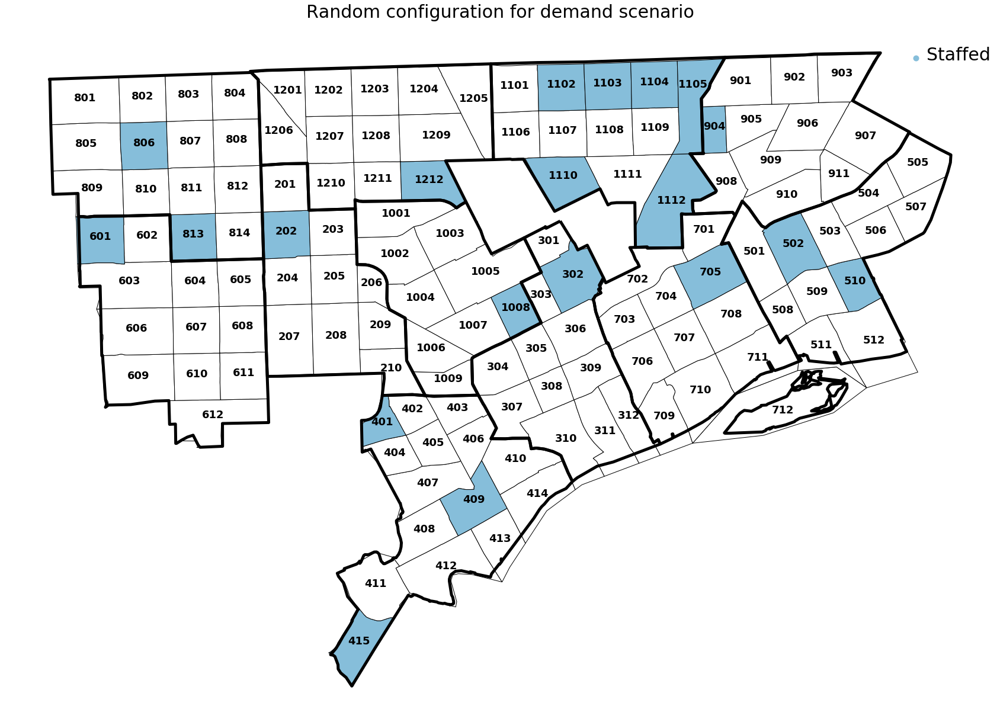

In [11]:
# targeted config
print('TARGETED')
plotConfig(targetted_config, title='Targeted configuration for demand scenario')
# random config
print('RANDOM')
plotConfig(random_config, title='Random configuration for demand scenario')

### Run the simulation

In [12]:
configuration = targetted_config # <- CHANGE HERE
ABM_STEP_TIME = 1 # <- CHANGING THIS IS NOT RECOMMENED
verbose=False

## Initialiaze model entity
print('Initialising model entity...')
trap = io.StringIO()
with redirect_stdout(trap):
    warnings.filterwarnings('ignore')
    model = ModelFramework.Model(ABM_env_scenario, configuration)
    warnings.filterwarnings('default')

#print('end_datetime', model.end_datetime)


## Run model
print('Running ABM...')
if verbose :
    agents_pos_all_steps, inc_pos_all_steps = model.run_model(ABM_STEP_TIME)
else :
    trap = io.StringIO()
    with redirect_stdout(trap):
        agents_pos_all_steps, inc_pos_all_steps = model.run_model(ABM_STEP_TIME)

## Evaluate model  
print('Evaluating ABM...')
df_metrics, sum_deterrence = model.evaluate_model()
#print(df_metrics)
avg_response_time = np.mean(df_metrics['Dispatch_time'] + df_metrics['Travel_time'])

## Get the percentage of responses that were failed
fail_threshold = 15 # <--- CHANGE HERE
# number of failed responses
num_failed= len(df_metrics[df_metrics['Dispatch_time'] + df_metrics['Travel_time'] > fail_threshold])
percent_failed=(num_failed/len(df_metrics))*100

print('>>> Results')
print('Avg. response time: {} mins'.format(avg_response_time))
print('Percentage failed responses: {} %'.format(percent_failed))
print('Sum of deterrence: {}'.format(sum_deterrence))


Initialising model entity...
Running ABM...
Evaluating ABM...
Statuses of incidents [1, 4, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1, 3, 4, 4, 4, 1, 4, 1, 4, 4, 4, 4, 4, 4, 4, 3, 4, 1, 1, 3]
Time period: 2019-03-19 08:00:00 - 2019-03-19 16:00:00
Total number of incidents for period: 35
Number of sorted incidents: 26/35
Average travel time per incident: 3 minutes
Average dispatch time per incident: 51 minutes
Average response time per incident: 53 minutes
Number of failed responses: 9
sum_deterrence 787
>>> Results
Avg. response time: 4.038461538461538 mins
Percentage failed responses: 0.0 %
Sum of deterrence: 787


In [13]:
### Createa GIF of the simulation 

In [14]:
# This may take some time...
ABM_NUM_STEPS = 20
model.make_gif(agents_pos_all_steps, inc_pos_all_steps, ABM_NUM_STEPS, path_to_root='../../')

/Users/natachachenevoy/Documents/GitHub/police-deployment-optimisation/dpd_case_study/ABM_running_example
Num steps in gif: 20
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20


/Users/natachachenevoy/Documents/GitHub/police-deployment-optimisation/dpd_case_study/ABM_running_example


<ipython-input-21-515c60e52fec>:3: ResourceWarning: unclosed file <_io.BufferedReader name='./ABM_animation_gif/20_agents/20_steps.gif'>
  display(Image(data=open('./ABM_animation_gif/20_agents/20_steps.gif','rb').read(), format='png'))


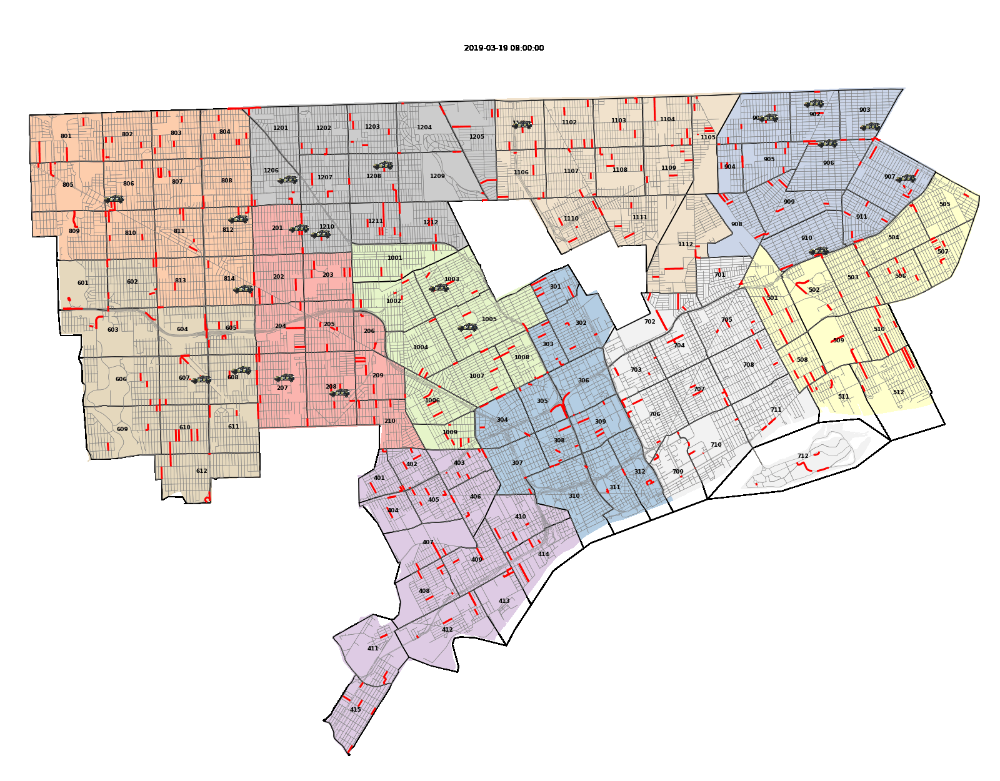

In [21]:
from IPython.display import Image
print(os.getcwd())
display(Image(data=open('./ABM_animation_gif/20_agents/20_steps.gif','rb').read(), format='png'))

So here we have it, a few simple steps to run an ABM for the case study of Detroit Police Department. The ABM simulates the spatial movements of police patrols as they respond to the incoming incidents that occured on the chosen shift (2019-03-19 08:00:00 to 2019-03-19 16:00:00). The red lines represent the hot streets in each patrol beat (determined upon initialisation of the ABM). The incidents appear as red circles.